In [1]:
# importing packages. See https://github.com/BasisResearch/collab-creatures for repo setup
import logging
import os
import time
import warnings


import numpy as np
import torch
import pyro
import pyro.distributions as dist

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

warnings.simplefilter(action="ignore", category=FutureWarning)

from collab.utils import find_repo_root

root = find_repo_root()
from collab.foraging import random_hungry_followers as rhf
from collab.foraging.toolkit import (
    add_velocities_to_data_object,
    construct_visibility,
    filter_by_visibility,
    generate_grid,
    generate_velocity_scores,
)


import plotly.express as px
import plotly.graph_objects as go
import pyro
import pyro.distributions as dist
import pyro.optim as optim
import torch
from pyro.infer import SVI, Predictive, Trace_ELBO
from pyro.infer.autoguide import AutoMultivariateNormal, init_to_mean


from collab.foraging import toolkit as ft

logging.basicConfig(format="%(message)s", level=logging.INFO)

# users can ignore smoke_test -- it's for automatic testing on GitHub, to make sure the notebook runs on future updates to the repository
smoke_test = "CI" in os.environ
num_frames = 5 if smoke_test else 50
num_svi_iters = 10 if smoke_test else 100
num_samples = 10 if smoke_test else 100

notebook_starts = time.time()


In [2]:
# data cleanup function

def prep_data_for_inference(sim_derived, features = [
            "proximity_standardized",
            "trace_standardized",
            "visibility",
            "velocity_score_standardized",
            "how_far",
            "how_far_squared_scaled",
        ]):
    df = sim_derived.derivedDF[features]

    df.dropna(inplace=True)

    for column in df.columns:
        df[column] = ft.normalize(df[column])

    data = torch.tensor(df.values, dtype=torch.float32)

    print(
        str(len(data))
        + " data points prepared for inference, dropped "
        + str(len(sim_derived.derivedDF) - len(data))
        + " rows with missing values."
    )

    return tuple(data[:, idx] for idx in range(data.shape[1]))
    # proximity, trace, visibility, velocity, how_far_score = (
    #     data[:, 0],
    #     data[:, 1],
    #     data[:, 2],
    #     data[:, 3],
    #     data[:, 4],
    # )



In [3]:
# generate random foragers simulation

random_foragers_sim = rhf.RandomForagers(
    grid_size=40,
    probabilities=[1, 2, 3, 2, 1, 2, 3, 2, 1],
    num_foragers=3,
    num_frames=num_frames,
    num_rewards=15,
    grab_range=3,
)

# simulate
random_foragers_sim()

/home/rafal/s78projects/collaborative-intelligence/collab/foraging/random_hungry_followers/random_foragers.py:163: UserWarning: Warning: forager movements truncated to grid size. Try running again, or increase grid size.
  warnings.warn(


## Copying without further filters or averaging

Consider agent 1. In the  simplest mode, at each frame, for each other agent $i$ in 1's visibility range, we calculate $i$'s velocity on the two axes in the last step, shift them to start at the position currently occupied by $1$ and assign scores to points with exponential decay function of distance from these "ideal" locations, summing them up accross all $i$'s.  

In [4]:
# derive predictors
random_foragers_derived = ft.derive_predictors(
    random_foragers_sim,  dropna=False,
    generate_velocity_indicator=True,
    visibility_range=20,   # agents will only copy from visible agents
    velocity_time_decay=1, # agents will only remember the last step
    velocity_spatial_decay=.15  # this captures how fast location attractiveness drops off
    # with distance
)

2024-05-28 18:20:19,704 - traces done
2024-05-28 18:20:20,066 - visibility done
2024-05-28 18:20:20,406 - proximity done
2024-05-28 18:20:20,571 - how_far done
2024-05-28 18:20:20,705 - derivedDF done
2024-05-28 18:20:20,705 - starting to generate velocity
2024-05-28 18:20:21,390 - velocity done


In [5]:
# rows are these are sampled points in space-time
print(random_foragers_derived.derivedDF.columns)

random_foragers_derived.derivedDF.head()

Index(['x', 'y', 'trace', 'time', 'trace_standardized', 'distance',
       'distance_x', 'distance_y', 'visibility', 'forager', 'proximity',
       'proximity_standardized', 'how_far_squared', 'how_far',
       'how_far_squared_scaled', 'velocity_score',
       'velocity_score_standardized'],
      dtype='object')


,x,y,trace,time,trace_standardized,distance,distance_x,distance_y,visibility,forager,proximity,proximity_standardized,how_far_squared,how_far,how_far_squared_scaled,velocity_score,velocity_score_standardized
0,14,7,0.033085,1,-0.671309,12.727922,9.0,9.0,0.540598,1,0.000441,-0.417973,221.0,14.866069,0.808160,0.296401,0.026327
1,14,7,0.033085,1,-0.671309,16.552945,7.0,15.0,0.267436,2,0.000832,-0.401553,180.0,13.416408,0.843750,0.166994,-0.433521
2,14,7,0.033085,1,-0.671309,12.649111,4.0,12.0,0.545795,3,0.000409,-0.408174,208.0,14.422205,0.819444,0.299926,0.023964
3,9,35,0.524618,1,1.166110,17.691806,12.0,13.0,0.180294,2,0.000001,-0.403924,377.0,19.416488,0.672743,0.140771,-0.522840
4,9,35,0.524618,1,1.166110,18.357560,9.0,16.0,0.128639,3,0.000003,-0.409319,425.0,20.615528,0.631076,0.127392,-0.561650


In [6]:
# first take a look at visibility for agent 1

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_visibility=1,
    plot_traces=False,
    plot_velocity=0,
)

In [7]:
# now plot velocity for agent 1

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_visibility=0,
    plot_traces=False,
    plot_velocity=1,
    velocity_multiplier= 7
)

In [8]:
features = [
            "proximity_standardized",
            "trace_standardized",
            "visibility",
            "velocity_score_standardized",
            "how_far",
            "how_far_squared_scaled",
        ]

proximity, trace, visibility, velocity, how_far, how_far_scaled = prep_data_for_inference(
    random_foragers_derived, features = features
)


125741 data points prepared for inference, dropped 2122 rows with missing values.


In [9]:
ft.visualise_forager_predictors(outcome = how_far_scaled, 
                             predictors = [trace, proximity, velocity, visibility],
                             predictor_names= ["trace", "proximity", "velocity", "visibility"],
                             outcome_name = "how_far_scaled")

In [10]:
random_foragers_derived.derivedDF.head()

,x,y,trace,time,trace_standardized,distance,distance_x,distance_y,visibility,forager,proximity,proximity_standardized,how_far_squared,how_far,how_far_squared_scaled,velocity_score,velocity_score_standardized
0,14,7,0.033085,1,-0.671309,12.727922,9.0,9.0,0.540598,1,0.000441,-0.417973,221.0,14.866069,0.808160,0.296401,0.026327
1,14,7,0.033085,1,-0.671309,16.552945,7.0,15.0,0.267436,2,0.000832,-0.401553,180.0,13.416408,0.843750,0.166994,-0.433521
2,14,7,0.033085,1,-0.671309,12.649111,4.0,12.0,0.545795,3,0.000409,-0.408174,208.0,14.422205,0.819444,0.299926,0.023964
3,9,35,0.524618,1,1.166110,17.691806,12.0,13.0,0.180294,2,0.000001,-0.403924,377.0,19.416488,0.672743,0.140771,-0.522840
4,9,35,0.524618,1,1.166110,18.357560,9.0,16.0,0.128639,3,0.000003,-0.409319,425.0,20.615528,0.631076,0.127392,-0.561650


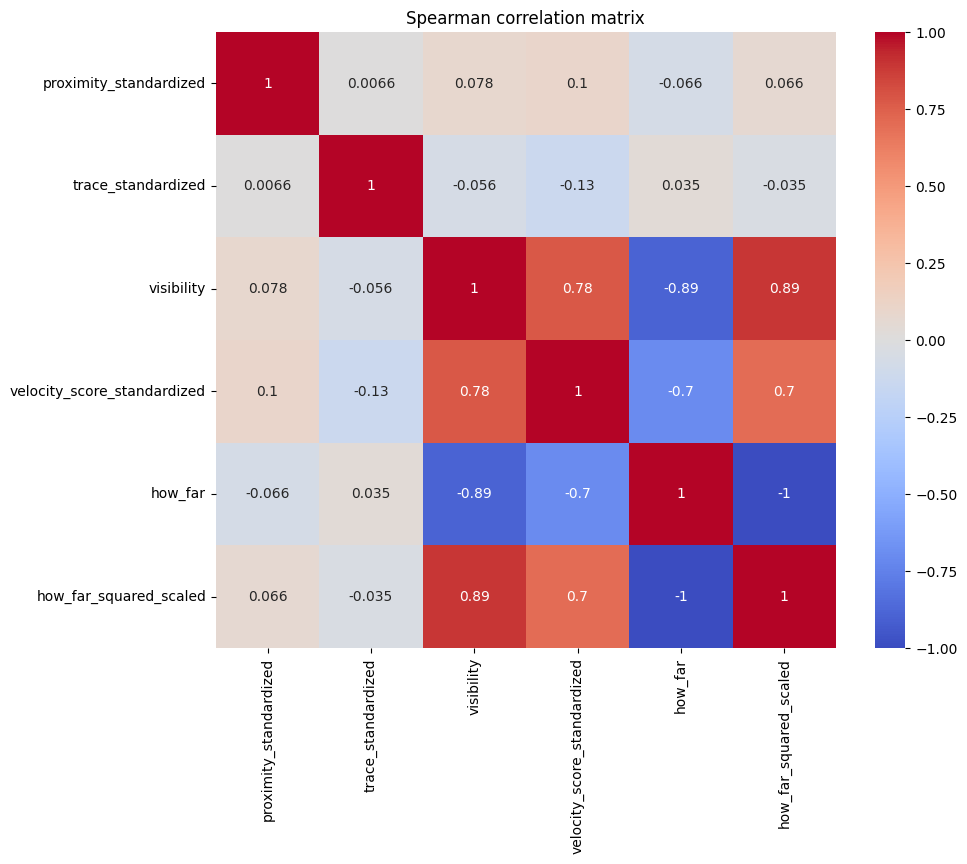

In [11]:
# notice visibility and velocity are highly correlated

correlation_matrix = random_foragers_derived.derivedDF[features].corr(method='spearman')

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Spearman correlation matrix')
plt.show()


In [12]:
# idea: see model error w/o and with velocity (investigate posterior variance due to colinearity, though)

def model_no_velocity(proximity, trace, visibility, how_far_score):
    p = pyro.sample("p", dist.Normal(0, 0.2))
    t = pyro.sample("t", dist.Normal(0, 0.2))
    vis = pyro.sample("vis", dist.Normal(0, 0.2))
    b = pyro.sample("b", dist.Normal(0.5, 0.3))

    ps = pyro.sample("ps", dist.Exponential(7))
    ts = pyro.sample("ts", dist.Exponential(7))
    vis_s = pyro.sample("vis_s", dist.Exponential(7))
    bs = pyro.sample("bs", dist.Exponential(7))

    sigma = pyro.deterministic(
        "sigma", bs + ps * proximity + ts * trace + vis_s * visibility
    )
    mean = pyro.deterministic("mean", b + p * proximity + t * trace + vis * visibility)

    with pyro.plate("data", len(proximity)):
        pyro.sample("how_far_scaled", dist.Normal(mean, sigma), obs = how_far_score)


In [13]:
def model_with_velocity(proximity, trace, visibility, velocity, how_far_score):
    p = pyro.sample("p", dist.Normal(0, 0.2))
    t = pyro.sample("t", dist.Normal(0, 0.2))
    vis = pyro.sample("vis", dist.Normal(0, 0.2))
    vel = pyro.sample("vel", dist.Normal(0, 0.2))
    b = pyro.sample("b", dist.Normal(0.5, 0.3))

    ps = pyro.sample("ps", dist.Exponential(7))
    ts = pyro.sample("ts", dist.Exponential(7))
    vis_s = pyro.sample("vis_s", dist.Exponential(7))
    vel_s = pyro.sample("vel_s", dist.Exponential(7))
    bs = pyro.sample("bs", dist.Exponential(7))

    sigma = pyro.deterministic(
        "sigma", bs + ps * proximity + ts * trace + vis_s * visibility + vel_s * velocity
    )

    mean = pyro.deterministic("mean", b + p * proximity + t * trace + vis * visibility + vel * velocity)

    with pyro.plate("data", len(proximity)):

        pyro.sample("how_far_scaled", dist.Normal(mean, sigma), obs = how_far_score)

In [29]:

def summary(samples, sites):
    site_stats = {}
    for site_name, values in samples.items():
        if site_name in sites:
            marginal_site = pd.DataFrame(values)
            describe = marginal_site.describe(
                percentiles=[0.05, 0.25, 0.5, 0.75, 0.95]
            ).transpose()
            site_stats[site_name] = describe[
                ["mean", "std", "5%", "25%", "50%", "75%", "95%"]
            ]
    return site_stats


def get_samples(model, num_svi_iters, num_samples, **kwargs):
    
    guide = AutoMultivariateNormal(model, init_loc_fn=init_to_mean)
    svi = SVI(model, guide, optim.Adam({"lr": 0.03}), loss=Trace_ELBO())

    iterations = []
    losses = []

    logging.info(f"Starting SVI inference with {num_svi_iters} iterations.")
    start_time = time.time()
    pyro.clear_param_store()
    for i in range(num_svi_iters):
        elbo = svi.step(**kwargs)
        iterations.append(i)
        losses.append(elbo)
        if i % 200 == 0:
            logging.info("Elbo loss: {}".format(elbo))
    end_time = time.time()
    elapsed_time = end_time - start_time
    logging.info("SVI inference completed in %.2f seconds.", elapsed_time)

    if not smoke_test:
        fig = px.line(
            x=iterations, y=losses, title="ELBO loss", template="presentation"
        )
        labels = {"iterations": "iteration", "losses": "loss"}
        fig.update_xaxes(showgrid=False, title_text=labels["iterations"])
        fig.update_yaxes(showgrid=False, title_text=labels["losses"])
        fig.update_layout(width=700)
        fig.show()

    predictive = Predictive(
        model, guide=guide, num_samples=num_samples, parallel=True)

    no_output_kwargs = kwargs.copy()
    no_output_kwargs.pop("how_far_score")


    print(no_output_kwargs.keys())


    preds = predictive(**no_output_kwargs, how_far_score = None)


    print(preds['how_far_scaled'])
    rhf_svi = {
        k: v.flatten().reshape(num_samples, -1).detach().cpu().numpy()
        for k, v in predictive(**kwargs).items()
        if k != "obs"
    }

    print("SVI-based coefficient marginals:")
    for site, values in summary(rhf_svi, ["t", "p", "vis", "vel"]).items():
        print("Site: {}".format(site))
        print(values, "\n")

    return {"svi_samples": rhf_svi, "svi_guide": guide, "svi_preds": preds}


In [30]:
samples_wo_velocity = get_samples(model_no_velocity, num_svi_iters=num_svi_iters , num_samples = num_samples,
             proximity=proximity, trace=trace, visibility=visibility, how_far_score=how_far_scaled)
               



2024-05-28 18:22:43,296 - Starting SVI inference with 100 iterations.
2024-05-28 18:22:43,332 - Elbo loss: -14978.997469305992
2024-05-28 18:22:44,604 - SVI inference completed in 1.31 seconds.


dict_keys(['proximity', 'trace', 'visibility'])
tensor([[0.5556, 0.5146, 0.6392,  ..., 0.6504, 0.4247, 0.5979],
        [0.6807, 0.6568, 0.6612,  ..., 0.6303, 0.2848, 0.7945],
        [0.5138, 0.4861, 0.6644,  ..., 0.6879, 0.4346, 0.9850],
        ...,
        [0.6014, 0.5155, 0.7824,  ..., 0.5093, 0.7594, 0.6717],
        [0.7690, 0.4410, 0.8240,  ..., 0.6552, 0.4948, 0.7752],
        [0.9667, 0.7035, 0.6782,  ..., 0.7907, 0.5354, 0.6551]])


In [ ]:


samples_w_velocity = get_samples(conditioned_model_with_velocity, num_svi_iters=num_svi_iters , num_samples = num_samples,
              proximity=proximity, trace=trace, visibility=visibility, velocity=velocity
                )

In [21]:
sp_wo = samples_wo_velocity["svi_samples"]



#preds_wo = sp_wo['b'].flatten() + sp_wo['p'].flatten() * proximity + sp_wo['t'].flatten() * trace + ['vis'].flatten() * visibility

TypeError: unsupported operand type(s) for *: 'numpy.ndarray' and 'Tensor'

In [ ]:


preds_wo_velocity = samples_wo_velocity["svi_preds"]['obs'].mean(axis=0)


samples_with_velocity = get_samples(model_with_velocity, num_svi_iters= num_svi_iters, num_samples = num_samples,
                proximity=proximity, trace=trace, visibility=visibility,
                velocity=velocity,
                how_far_score=how_far_scaled)

mean_preds_with_velocity = samples_with_velocity["svi_preds"]['obs'].mean(axis=0)


print(mean_preds_with_velocity)


# null_model_absolute_errors =  torch.abs(how_far_scaled - torch.mean(how_far_scaled)).numpy()
# wo_model_absolute_errors = torch.abs(how_far_scaled - mean_preds_wo_velocity).numpy()
# with_model_absolute_errors = torch.abs(how_far_scaled - mean_preds_with_velocity).numpy()

# null_mean = np.mean(null_model_absolute_errors)
# wo_mean = np.mean(wo_model_absolute_errors)
# with_mean = np.mean(with_model_absolute_errors)


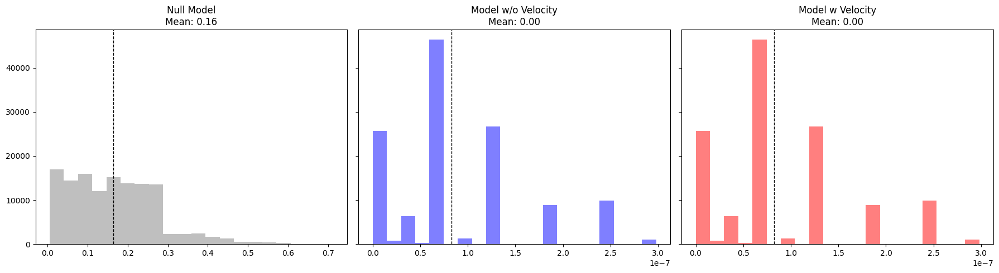

In [19]:

fig, axs = plt.subplots(1, 3, figsize=(18, 5), sharey=True)

axs[0].hist(null_model_absolute_errors, bins=20, color="grey", alpha=0.5)
axs[0].axvline(null_mean, color='black', linestyle='dashed', linewidth=1)
axs[0].set_title(f"Null Model\nMean: {null_mean:.2f}")

axs[1].hist(wo_model_absolute_errors, bins=20, color="blue", alpha=0.5)
axs[1].axvline(wo_mean, color='black', linestyle='dashed', linewidth=1)
axs[1].set_title(f"Model w/o Velocity\nMean: {wo_mean:.2f}")

axs[2].hist(with_model_absolute_errors, bins=20, color="red", alpha=0.5)
axs[2].axvline(with_mean, color='black', linestyle='dashed', linewidth=1)
axs[2].set_title(f"Model w Velocity\nMean: {with_mean:.2f}")


plt.tight_layout()
plt.show()